# Set environment variables 

<font color="#445555">**Once you've set your Cloud Environment and loaded any needed packages, you're ready to start your analysis!**

In [2]:
%%capture
from firecloud import api as fapi
import os
import io
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

<font color="#445555">**Why is this necessary?**   
    To load the data into the notebook VM requires some information about the Terra workspace. You can access this programmatically by taking advantage of several useful environment variables, such as the workspace Google project and the workspace name. Pulling these pre-defined variables into the notebook VM makes the notebook work out-of-the-box without having to cut and paste **your specific variables** - even if you are running in a copy of the original workspace (with a different workspace name and workspace storage ID). 

In [3]:
# Get the Google billing project name and workspace name
project = os.environ['WORKSPACE_NAMESPACE']
workspace = os.environ['WORKSPACE_NAME']
bucket = os.environ['WORKSPACE_BUCKET'] + "/"

# Verify that we've captured the environment variables
print("Terra Billing project: " + project)
print("Workspace: " + workspace)
print("Workspace storage bucket: " + bucket)

Terra Billing project: foxg1-terra-billing-project
Workspace: foxg1-data-analysis
Workspace storage bucket: gs://fc-secure-1dd24c56-9f75-4720-a955-258cc33dbbc4/


# Load patient data
First, load the data from the `patient_uuid` table in a pandas dataframe.   

Note that if you are **not using the standard genomic data model (i.e. participant, sample, pairs tables),** you will **need to include 'model = "flexible" in the command**.

In [4]:
# Get all of the data from the patient_uuid table and load into a pandas dataframe
patient_table = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "patient_uuid", model = "flexible").text), sep='\t')
patient_table.rename(columns = {'entity:patient_uuid_id':'patient_uuid'}, inplace = True)
patient_table.set_index('patient_uuid', inplace = True)

clinical_diagnosis_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis", model = "flexible").text), sep='\t')
medications_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "medication", model = "flexible").text), sep='\t')
exam_findings_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "exam_findings", model = "flexible").text), sep='\t')
clinical_features_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis_features", model = "flexible").text), sep='\t')



/tmp/ipykernel_90/453197087.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_90/453197087.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_90/453197087.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

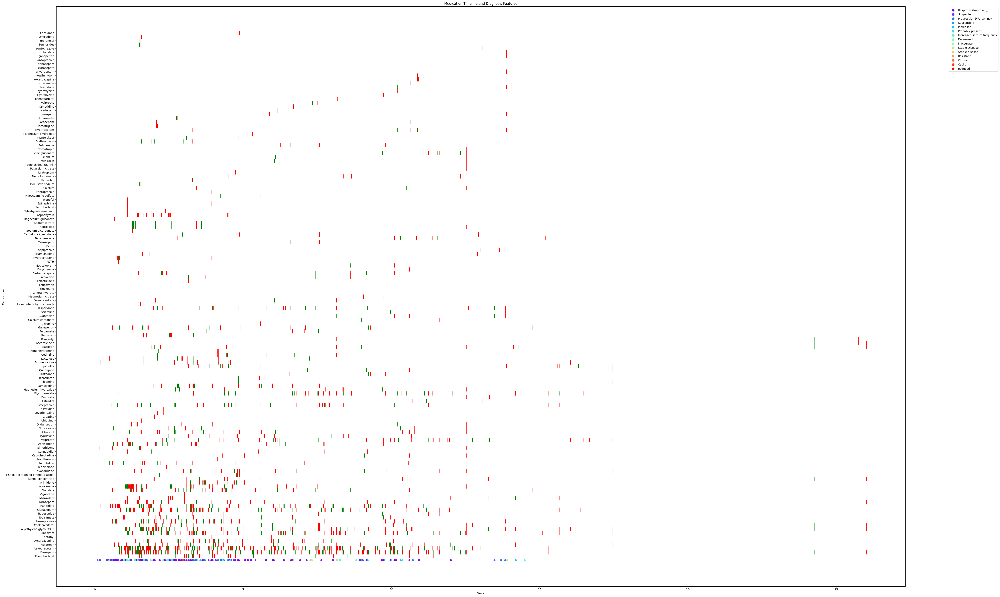

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D

# Assuming clinical_diagnosis_df, medications_df, and clinical_features_df are defined.

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_patients = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications
filtered_medications = medications_df[medications_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]

# Get unique medications and their start/end dates converted to years
filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25
unique_medications = filtered_medications['medication'].unique()

# Get the clinical diagnosis features for the filtered patients
filtered_features = clinical_features_df[clinical_features_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]
filtered_features['diagnosis_feature_year'] = filtered_features['diagnosis_feature_age_days'] / 365.25

# Set up your figure and axes
fig, ax = plt.subplots(figsize=(50, 30))  # Adjust the size as needed

# Colors for each diagnosis feature
features_unique = filtered_features['diagnosis_feature'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(features_unique)))
color_dict = {feature: color for feature, color in zip(features_unique, colors)}

# Plot each medication's start and end dates with green and red arrows
for medication in unique_medications:
    medication_data = filtered_medications[filtered_medications['medication'] == medication]
    y_pos = np.where(unique_medications == medication)[0][0]
    for _, row in medication_data.iterrows():
        ax.plot([row['medication_start_year'], row['medication_start_year']], [y_pos, y_pos],
                color='green', marker='|', markersize=15, markeredgewidth=2)
        ax.plot([row['medication_end_year'], row['medication_end_year']], [y_pos, y_pos],
                color='red', marker='|', markersize=15, markeredgewidth=2)

# Plot diagnosis features
for _, row in filtered_features.iterrows():
    feature = row['diagnosis_feature']
    color = color_dict.get(feature, 'black')  # Default to black if not found
    y_pos = -1  # Placeholder; determine the correct y position for each feature
    ax.scatter(row['diagnosis_feature_year'], y_pos, color=color, label=feature)

# Set y-axis with medication names
ax.set_yticks(range(len(unique_medications)))
ax.set_yticklabels(unique_medications)

# Create a custom legend for the diagnosis features
legend_elements = [Line2D([0], [0], marker='o', color='w', label=feature, 
                          markerfacecolor=color_dict[feature], markersize=10) for feature in features_unique]
ax.legend(handles=legend_elements, bbox_to_anchor=(1.05, 1), loc='upper left')

ax.set_xlabel('Years')
ax.set_ylabel('Medications')
ax.set_title('Medication Timeline and Diagnosis Features')

plt.tight_layout()  # Adjust the layout
plt.show()





Below piece of code is going to find 35 patients suffering from chorea related clinical diagnosis. Then it finds 126 unique medications that patient were taking. Then to observe impact of medicine on patient, it create grpahs by medication indication category, which is for what reason a medication was given to patient. For e.g. for ADHD what medications were taken by 35 patients temporally.  This code also searches, 35 patients in clinical_diagnosis_features table to see how their  features were progressing. Now ,  clinical_diagnosis_feature table has for what disease the progression is, but the disease names in this table are different somewhat than disease names in medication table i.e. medication_indication category. So first, lets generate a graph temporally where 35 patients were taking medications for a specific medication indication category. Then lets overlay symmptom progressions for 35 patients on this plot as well temporally. Keep in mind, this symptom progressions are not filtered here to show for what disease the progression was . That will be done as subsequent step in following graph. 

/tmp/ipykernel_90/3116043478.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_90/3116043478.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_90/3116043478.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

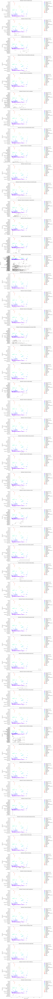

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D

# Assuming your DataFrame loading code is here

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_patients = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications
filtered_medications = medications_df[medications_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]

# Convert age days to years for medications
filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25

# Get the clinical diagnosis features for the filtered patients
filtered_features = clinical_features_df[clinical_features_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]
filtered_features['diagnosis_feature_year'] = filtered_features['diagnosis_feature_age_days'] / 365.25

# Get unique colors for each diagnosis feature
features_unique = filtered_features['diagnosis_feature'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(features_unique)))
color_dict = {feature: color for feature, color in zip(features_unique, colors)}

# Group medications by indication
grouped_medications = filtered_medications.groupby('medication_indication')

# Set up the matplotlib figure and axes
num_indications = len(grouped_medications)
fig, axes = plt.subplots(num_indications, figsize=(15, 5 * num_indications), sharex=True)

# Flatten axes array in case of a single row of subplots
if num_indications == 1:
    axes = np.array([axes])

# Plot each medication's start and end dates with green and red markers
for (medication_indication, group), ax in zip(grouped_medications, axes.flatten()):
    for _, row in group.iterrows():
        ax.plot([row['medication_start_year'], row['medication_end_year']], 
                [row['medication'], row['medication']],
                color='grey', linestyle='-', marker='|', markersize=10, markeredgewidth=2)
        ax.scatter([row['medication_start_year']], [row['medication']], color='green', marker='|', s=100)
        ax.scatter([row['medication_end_year']], [row['medication']], color='red', marker='|', s=100)

    # Plot diagnosis features for the current medication indication
    for _, row in filtered_features.iterrows():
        feature = row['diagnosis_feature']
        color = color_dict.get(feature, 'black')  # Default to black if not found
        ax.scatter(row['diagnosis_feature_year'], feature, color=color, label=feature)

    # Formatting the subplot
    ax.set_title(f'Medication Timeline for {medication_indication}')
    ax.set_ylabel('Medications')

    # Create legend for the current subplot using the features and their corresponding colors
    custom_lines = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[feature], 
                          label=feature, markersize=10) for feature in features_unique]
    ax.legend(handles=custom_lines, bbox_to_anchor=(1.05, 1), loc='upper left')

# Outside the loop: set common X label and adjust the layout
plt.xlabel('Years since birth')
plt.tight_layout()
plt.show()


Following up on above graph that is generated by medication indication category, what we need to do next is use medication _ indication category i.e. disease name in each graph and then filter out diansosis progresson dataframe with that disease name of closely matching disease name from clinical diangosis feature table - diagnosis column. This way we only filter out diagnosis features for that diseases and observer the impact of the medication. Basically, what we are doing is 35 patients who had chorea are fileterd across medication and clinical diangosis feature table. Now for each disease category, we are seeing what is clinical diangosis feature progression with medication. Since disease names are different in clinical diangosis feature and medication table, we need to apply filtering here by manually updating code, since we only can tell which disease are same even though they are named differently.

/tmp/ipykernel_97/3651026238.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_97/3651026238.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_97/3651026238.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

clinical diangosis feature - disease names - diagnosis column
----------------------------------------------------------------
['Vomiting' 'Epileptic spasms' 'Encephalopathy' 'Cyanosis'
 'Adrenal insufficiency' 'Pleural effusion' 'Constipation'
 'Gastroesophageal reflux disease (GERD)' 'Failure to thrive'
 'Slow weight gain' 'Abnormal gait' 'Hypoventilation' 'Muscle weakness'
 'Visual impairment' 'Pulmonary aspiration' 'Epilepsy' 'Seasonal allergy'
 'Myoclonus' 'Unintentional weight loss' 'Scoliosis deformity of spine'
 'Underweight' 'Sialorrhea' 'Disturbance in sleep behavior'
 'Diabetes mellitus' 'Irritability' 'Esotropia' 'Problem behavior'
 'Self-injurious behavior' 'Single seizure' 'Chorea' 'Stereotypy'
 'Chronic constipation' 'Strabismus' 'Aspiration pneumonia'
 'Mitochondrial Myopathy' 'Restlessness' 'Insomnia'
 'Localization-related epilepsy' 'Feeding problem' 'Hypotonia'
 'Clostridioides difficile infection' 'Choreoathetosis' 'Feeling agitated'
 'Seizure' 'Cranial nerve VI pal

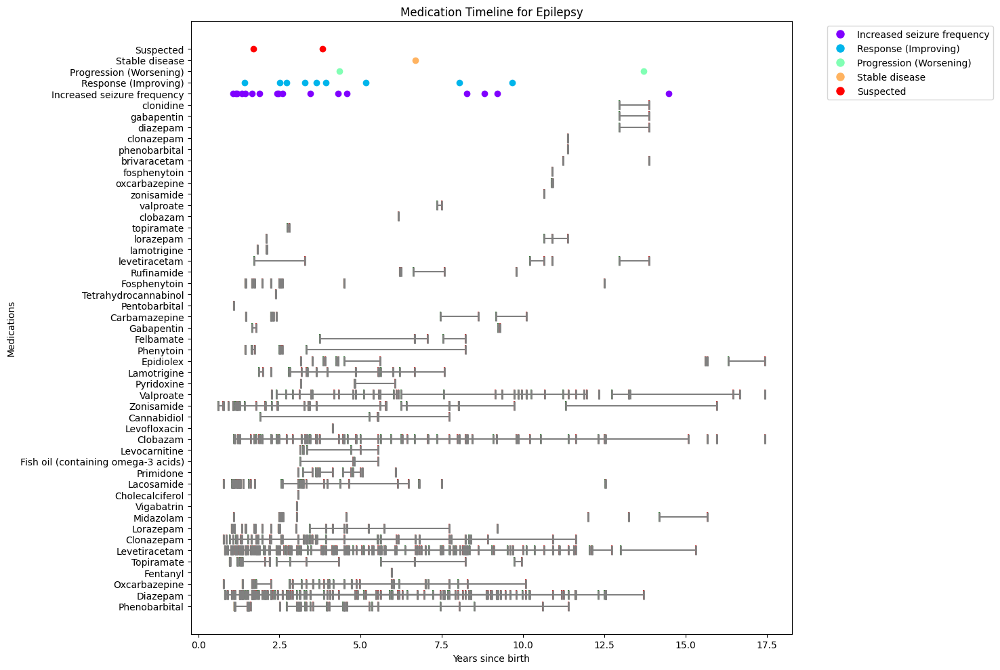

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D

# Assuming your DataFrame loading code is here

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_patients = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications
filtered_medications = medications_df[medications_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]

# Convert age days to years for medications
filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25

# Get the clinical diagnosis features for the filtered patients
filtered_features = clinical_features_df[clinical_features_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]
filtered_features['diagnosis_feature_year'] = filtered_features['diagnosis_feature_age_days'] / 365.25

## Print all unique medication indication and diagnosis 
print("chorea patients all disease names  - diagnosis column in clinical diangosis feature")
print("----------------------------------------------------------------")

print(filtered_features['diagnosis'].unique())
print("##################################################################")
print("chorea patients all disease names - medication_indication in column medication table")
print("----------------------------------------------------------------")

print(filtered_medications['medication_indication'].unique())


# Adding code here so that we filter filtered_features by a particular diagnosis or disease, so that we
# are only seeing the symptom progression for that disease only
#filtered_features = filtered_features[filtered_features['diagnosis'].isin(["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"])]
#filtered_features = filtered_features[filtered_features['diagnosis'].isin(["Constipation", "Chronic constipation"])]
filtered_features = filtered_features[filtered_features['diagnosis'].isin(["Epilepsy","Generalized epilepsy","Localization-related epilepsy","Refractory epilepsy"])]


# Lets do the same here as well for medication table so that we are only filtering on a particular disease
# We will always use the graph from previous cell to know what diseases for which they were taking the medications
# this cell allows to filter more at granular level for each disease the graph and symptom progression

filtered_medications = filtered_medications[filtered_medications['medication_indication'].isin(["Epilepsy","Generalized epilepsy","Localization-related epilepsy","Refractory epilepsy"])]
# since all these conditions mean same thing, lets put same column name, to show consolidated graph
filtered_medications['medication_indication'] = "Epilepsy"


# Get unique colors for each diagnosis feature
features_unique = filtered_features['diagnosis_feature'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(features_unique)))
color_dict = {feature: color for feature, color in zip(features_unique, colors)}

# Group medications by indication
grouped_medications = filtered_medications.groupby('medication_indication')

# Set up the matplotlib figure and axes
num_indications = len(grouped_medications)
fig, axes = plt.subplots(num_indications, figsize=(15, 10 * num_indications), sharex=True)

# Flatten axes array in case of a single row of subplots
if num_indications == 1:
    axes = np.array([axes])

# Plot each medication's start and end dates with green and red markers
for (medication_indication, group), ax in zip(grouped_medications, axes.flatten()):
    for _, row in group.iterrows():
        ax.plot([row['medication_start_year'], row['medication_end_year']], 
                [row['medication'], row['medication']],
                color='grey', linestyle='-', marker='|', markersize=10, markeredgewidth=2)
        ax.scatter([row['medication_start_year']], [row['medication']], color='green', marker='|', s=100)
        ax.scatter([row['medication_end_year']], [row['medication']], color='red', marker='|', s=100)

    # Plot diagnosis features for the current medication indication
    for _, row in filtered_features.iterrows():
        feature = row['diagnosis_feature']
        color = color_dict.get(feature, 'black')  # Default to black if not found
        ax.scatter(row['diagnosis_feature_year'], feature, color=color, label=feature)

    # Formatting the subplot
    ax.set_title(f'Medication Timeline for {medication_indication}')
    ax.set_ylabel('Medications')

    # Create legend for the current subplot using the features and their corresponding colors
    custom_lines = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[feature], 
                          label=feature, markersize=10) for feature in features_unique]
    ax.legend(handles=custom_lines, bbox_to_anchor=(1.05, 1), loc='upper left')

# Outside the loop: set common X label and adjust the layout
plt.xlabel('Years since birth')
plt.tight_layout()
plt.show()


This code below does same as above. Except instead of using medication_indication as catgory for a disease, it uses diagnosis column from clinical diagnosis features as a category for a disease. This way we are showing sympotom progression specifically for a disease but in medications we are not just showing medications that were taken for that disease, but rather all the medications that were taken by the patients who were showing disease and disease progresson. So basically, same problem here since patient id is link. If we have disease category common between medication and clinical diagnosis table, its will show data clearly. This might a better graph, since we know for a particular disease what are the medications that are given, so visually we can filter those out. So what we are left with is, for a disease what was its progression and which medication patient was taking during that time. This is exactly what we want. 

/tmp/ipykernel_90/3343912537.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications_df['medication_start_year'] = filtered_medications_df['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_90/3343912537.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications_df['medication_end_year'] = filtered_medications_df['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_90/3343912537.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

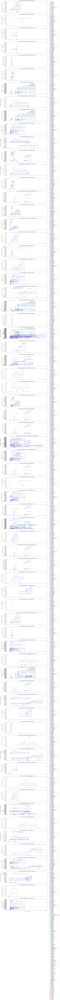

In [58]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.lines import Line2D
import matplotlib.colors as mcolors

clinical_diagnosis_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis", model = "flexible").text), sep='\t')
medications_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "medication", model = "flexible").text), sep='\t')
exam_findings_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "exam_findings", model = "flexible").text), sep='\t')
clinical_features_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis_features", model = "flexible").text), sep='\t')


# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_diagnosis_df = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications and features
filtered_patient_uuids = filtered_diagnosis_df['patient_uuid'].unique()
filtered_medications_df = medications_df[medications_df['patient_uuid'].isin(filtered_patient_uuids)]
filtered_features_df = clinical_features_df[clinical_features_df['patient_uuid'].isin(filtered_patient_uuids)]

# Convert age days to years for medications
filtered_medications_df['medication_start_year'] = filtered_medications_df['medication_age_days_firstDate'] / 365.25
filtered_medications_df['medication_end_year'] = filtered_medications_df['medication_age_days_lastDate'] / 365.25

# Convert age days to years for clinical features
filtered_features_df['diagnosis_feature_year'] = filtered_features_df['diagnosis_feature_age_days'] / 365.25

# Get unique colors for each medication
medications_unique = filtered_medications_df['medication'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(medications_unique)))
color_dict = {medication: color for medication, color in zip(medications_unique, colors)}

# Group clinical features by diagnosis
grouped_features = filtered_features_df.groupby('diagnosis')

# Set up the matplotlib figure and axes
num_diagnoses = len(grouped_features)
fig, axes = plt.subplots(num_diagnoses, figsize=(15, 5 * num_diagnoses), sharex=True)

# Flatten axes array in case of a single row of subplots
if num_diagnoses == 1:
    axes = np.array([axes])

# Plot each group of diagnosis features and associated medications
for (diagnosis, features_group), ax in zip(grouped_features, axes.flatten()):
    # For each feature in this diagnosis category, plot the feature over time
    for _, feature_row in features_group.iterrows():
        ax.scatter(feature_row['diagnosis_feature_year'], feature_row['diagnosis_feature'],
                   color='black', label='Diagnosis Feature')

    # Get all medications for the patients with the current diagnosis
    diagnosis_patient_uuids = features_group['patient_uuid'].unique()
    diagnosis_medications = filtered_medications_df[filtered_medications_df['patient_uuid'].isin(diagnosis_patient_uuids)]

    # Plot each medication for the current diagnosis
    for _, med_row in diagnosis_medications.iterrows():
        color = color_dict.get(med_row['medication'], 'grey')  # Default to grey if not found
        ax.plot([med_row['medication_start_year'], med_row['medication_end_year']],
                [med_row['medication'], med_row['medication']],
                color=color, linestyle='-', marker='|', markersize=10, markeredgewidth=2)
        ax.scatter([med_row['medication_start_year']], [med_row['medication']], color='green', marker='|', s=100)
        ax.scatter([med_row['medication_end_year']], [med_row['medication']], color='red', marker='|', s=100)

    # Formatting the subplot
    ax.set_title(f'Features and Medication Timeline for {diagnosis}')
    ax.set_ylabel('Diagnosis Features / Medications')
    
    ax.tick_params(axis='y', labelsize=6)

    # Create a legend for the current subplot using the medications and their corresponding colors
    custom_lines = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[medication], 
                          label=medication, markersize=10) for medication in medications_unique]
    ax.legend(handles=custom_lines, bbox_to_anchor=(1.05, 1), loc='upper left')

# Outside the loop: set common X label and adjust the layout
plt.xlabel('Years since birth')
plt.tight_layout()
plt.show()


In [56]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import numpy as np
import io 


# Assuming fapi is a library or module you are using to fetch data

# Assuming the fapi.get_entities_tsv is a function you have defined to get your data
# Replace 'project', 'workspace', and 'model' with your actual parameters
clinical_diagnosis_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis", model = "flexible").text), sep='\t')
medications_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "medication", model = "flexible").text), sep='\t')
clinical_features_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis_features", model = "flexible").text), sep='\t')

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_diagnosis_df = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications and features
filtered_patient_uuids = filtered_diagnosis_df['patient_uuid'].unique()
filtered_medications_df = medications_df[medications_df['patient_uuid'].isin(filtered_patient_uuids)]
filtered_features_df = clinical_features_df[clinical_features_df['patient_uuid'].isin(filtered_patient_uuids)]

# Convert age days to years for medications and features
filtered_medications_df['medication_start_year'] = filtered_medications_df['medication_age_days_firstDate'] / 365.25
filtered_medications_df['medication_end_year'] = filtered_medications_df['medication_age_days_lastDate'] / 365.25
filtered_features_df['diagnosis_feature_year'] = filtered_features_df['diagnosis_feature_age_days'] / 365.25

# Group clinical features by diagnosis_feature
grouped_features = filtered_features_df.groupby('diagnosis_feature')

# Set up the matplotlib figure and axes
num_features = len(grouped_features)
subplot_height = 30  # Adjust as needed to fit the plot
#fig_height = min(subplot_height * num_features, 30)  # Limit the figure height to 30 inches
fig_height = subplot_height * num_features
fig, axes = plt.subplots(num_features, figsize=(15, fig_height), sharex=True)

# Flatten axes array in case of a single row of subplots
if num_features == 1:
    axes = [axes]

# Plot each group of diagnosis features and associated medications
for (feature_name, feature_group), ax in zip(grouped_features, axes):
    # Plot the feature over time for this diagnosis feature
    ax.scatter(feature_group['diagnosis_feature_year'], feature_group['diagnosis_feature'],
               color='black', label='Diagnosis Feature')

    # Get all medications for the patients with the current diagnosis feature
    feature_patient_uuids = feature_group['patient_uuid'].unique()
    feature_medications = filtered_medications_df[filtered_medications_df['patient_uuid'].isin(feature_patient_uuids)]

    # Plot each medication for the current diagnosis feature
    for _, med_row in feature_medications.iterrows():
        ax.plot([med_row['medication_start_year'], med_row['medication_end_year']],
                [med_row['medication'], med_row['medication']],
                color='grey', linestyle='-', marker='|', markersize=10, markeredgewidth=2)
        ax.scatter([med_row['medication_start_year']], [med_row['medication']], color='green', marker='|', s=100)
        ax.scatter([med_row['medication_end_year']], [med_row['medication']], color='red', marker='|', s=100)

    # Formatting the subplot
    ax.set_title(f'Features and Medication Timeline for {feature_name}')
    ax.set_ylabel('Diagnosis Features / Medications')

    # Set legend for medications if necessary
    # This part is optional, you can customize the legend as per your requirements

# Set common X label and adjust the layout
plt.xlabel('Years since birth')
plt.tight_layout()
plt.show()


/tmp/ipykernel_90/1005374950.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications_df['medication_start_year'] = filtered_medications_df['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_90/1005374950.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications_df['medication_end_year'] = filtered_medications_df['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_90/1005374950.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

/tmp/ipykernel_90/2565816887.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications_df['medication_start_year'] = filtered_medications_df['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_90/2565816887.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications_df['medication_end_year'] = filtered_medications_df['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_90/2565816887.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

List of Unique Diagnosis Features:
['Response (Improving)' 'Suspected' 'Progression (Worsening)'
 'Susceptible' 'Increased' 'Probably present'
 'Increased seizure frequency' 'Decreased' 'Inaccurate' 'Stable Disease'
 'Stable disease' 'Resistant' 'Chronic' 'Cyclic' 'Reduced']


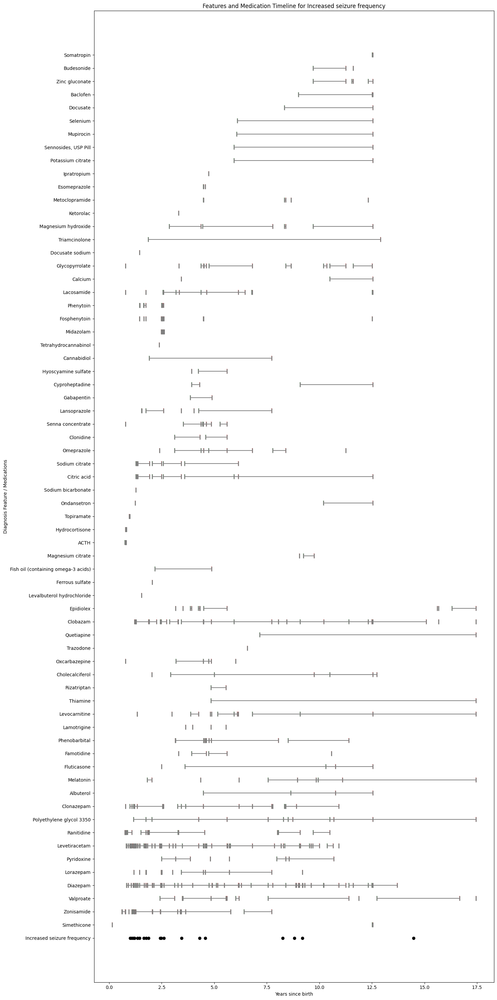

In [48]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import numpy as np
import io 


# Assuming fapi is a library or module you are using to fetch data

# Assuming the fapi.get_entities_tsv is a function you have defined to get your data
# Replace 'project', 'workspace', and 'model' with your actual parameters
clinical_diagnosis_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis", model = "flexible").text), sep='\t')
medications_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "medication", model = "flexible").text), sep='\t')
clinical_features_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "clinical_diagnosis_features", model = "flexible").text), sep='\t')

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_diagnosis_df = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications and features
filtered_patient_uuids = filtered_diagnosis_df['patient_uuid'].unique()
filtered_medications_df = medications_df[medications_df['patient_uuid'].isin(filtered_patient_uuids)]
filtered_features_df = clinical_features_df[clinical_features_df['patient_uuid'].isin(filtered_patient_uuids)]

# Convert age days to years for medications and features
filtered_medications_df['medication_start_year'] = filtered_medications_df['medication_age_days_firstDate'] / 365.25
filtered_medications_df['medication_end_year'] = filtered_medications_df['medication_age_days_lastDate'] / 365.25
filtered_features_df['diagnosis_feature_year'] = filtered_features_df['diagnosis_feature_age_days'] / 365.25

# Group clinical features by diagnosis_feature
grouped_features = filtered_features_df.groupby('diagnosis_feature')

# Unique diagnostic features
unique_diagnosis_features = filtered_features_df['diagnosis_feature'].unique()
print("List of Unique Diagnosis Features:")
print(unique_diagnosis_features)

# Let's say you choose one feature to plot
# For example, if you want to plot for the first feature in the list, you can do this:
feature_to_plot = unique_diagnosis_features[6]  # or set it to any feature you want to plot

# Now filter the DataFrame for the chosen feature
chosen_feature_df = filtered_features_df[filtered_features_df['diagnosis_feature'] == feature_to_plot]

# Continue with plotting as before, but only for the chosen feature
fig, ax = plt.subplots(figsize=(15, 30))  # Adjust the size as needed

# Plot the chosen feature over time
ax.scatter(chosen_feature_df['diagnosis_feature_year'], chosen_feature_df['diagnosis_feature'],
           color='black', label='Diagnosis Feature')

# Get all medications for the patients with the chosen diagnosis feature
chosen_feature_patient_uuids = chosen_feature_df['patient_uuid'].unique()
chosen_feature_medications = filtered_medications_df[filtered_medications_df['patient_uuid'].isin(chosen_feature_patient_uuids)]

# Plot each medication for the chosen diagnosis feature
for _, med_row in chosen_feature_medications.iterrows():
    ax.plot([med_row['medication_start_year'], med_row['medication_end_year']],
            [med_row['medication'], med_row['medication']],
            color='grey', linestyle='-', marker='|', markersize=10, markeredgewidth=2)
    ax.scatter([med_row['medication_start_year']], [med_row['medication']], color='green', marker='|', s=100)
    ax.scatter([med_row['medication_end_year']], [med_row['medication']], color='red', marker='|', s=100)

# Formatting the plot
ax.set_title(f'Features and Medication Timeline for {feature_to_plot}')
ax.set_ylabel('Diagnosis Feature / Medications')
ax.set_xlabel('Years since birth')

# Set legend for medications if necessary
# This part is optional, you can customize the legend as per your requirements

plt.tight_layout()
plt.show()



Lets reuse the logic above, to filter patients suffering from chorea related symptoms in other categories to see , their progression. This one tries to identify exam findings and medication temporally for chorea patients.

/tmp/ipykernel_97/2100879778.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_97/2100879778.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_97/2100879778.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

chorea patients all disease names - medication_indication column medication table
----------------------------------------------------------------
['Epilepsy' nan 'Disturbance in sleep behavior' 'Constipation'
 'Osteopenia' 'Gastroesophageal reflux disease (GERD)' 'Laryngomalacia'
 'Choreoathetosis' 'Sialorrhea' 'Chronic constipation'
 'Ineffective airway clearance' 'Insomnia' 'Hypothyroidism'
 'Chorea-athetoid cerebral palsy' 'Feeling agitated' 'Asthma'
 'Respiratory compromise' 'Disorders of initiating and maintaining sleep'
 'Severe global developmental delay' 'Headache' 'Vitamin D deficiency'
 'Intolerance to food' 'Dystonia' 'Osteoporosis (bone loss)'
 'Refractory epilepsy' 'Recurrent pneumonia' 'Vomiting' 'Irritability'
 'Problem behavior' 'Chorea' 'Reactive airway disease'
 'Localization-related epilepsy' 'Clostridioides difficile infection'
 'Hypotonia' 'Mitochondrial Myopathy' 'Infantile spasms' 'Chronic cough'
 'Spasticity' 'Seizure' 'Lennox-Gastaut syndrome' 'Dyssomnia'
 'Lo

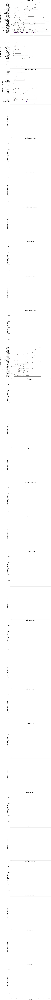

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D

# Assuming your DataFrame loading code is here
exam_findings_df = pd.read_csv(io.StringIO(fapi.get_entities_tsv(project, workspace, "exam_findings", model = "flexible").text), sep='\t')

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_patients = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications
filtered_medications = medications_df[medications_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]

# Convert age days to years for medications
filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25

# Get the exam_findings for the filtered patients
filtered_exam_findings_df = exam_findings_df[exam_findings_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]
filtered_exam_findings_df['exam_age_year'] = filtered_exam_findings_df['exam_age_days'] / 365.25

## Print all unique medication indication
print("chorea patients all disease names - medication_indication column medication table")
print("----------------------------------------------------------------")

print(filtered_medications['medication_indication'].unique())

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D

# Your DataFrame loading code here
# ...

# Filter exam_findings by 'exam_section' = 'coordination'
coordination_exam_findings_df = filtered_exam_findings_df[filtered_exam_findings_df['exam_section'] == 'coordination']

# Get unique exam findings
unique_exam_findings = coordination_exam_findings_df['exam_finding'].unique()

print("----------------------------------------------------------------")
print("----------------------------------------------------------------")
print("chorea patients - Unique exam findings in coordination section")
print(unique_exam_findings)

#Filter coordination dataframe more by exam_findings 
coordination_exam_findings_df = filtered_exam_findings_df[filtered_exam_findings_df['exam_finding'].isin(['Hyperkinesis', 'Chorea' ,'Abnormal involuntary movement', 'Uncoordinated movements'])]


# Get unique colors for each exam finding
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_exam_findings)))
color_dict = {finding: color for finding, color in zip(unique_exam_findings, colors)}

# Set up the matplotlib figure and axes
fig, axes = plt.subplots(len(unique_exam_findings), figsize=(15, 10 * len(unique_exam_findings)), sharex=True)

# Ensure axes is an array even if there's only one plot
if len(unique_exam_findings) == 1:
    axes = np.array([axes])

# Plotting
for finding, ax in zip(unique_exam_findings, axes.flatten()):
    # Filter exam findings for the current finding
    current_finding_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding'] == finding]

    # Plot exam findings
    ax.scatter(current_finding_df['exam_age_year'], [finding] * len(current_finding_df), color=color_dict[finding], label=finding)

    # Plot medications for patients with the current exam finding
    for _, row in filtered_medications.iterrows():
        if row['patient_uuid'] in current_finding_df['patient_uuid'].unique():
            ax.plot([row['medication_start_year'], row['medication_end_year']], 
                    [row['medication'], row['medication']],
                    color='grey', linestyle='-', marker='|', markersize=10, markeredgewidth=2)
            ax.scatter([row['medication_start_year']], [row['medication']], color='green', marker='|', s=100)
            ax.scatter([row['medication_end_year']], [row['medication']], color='red', marker='|', s=100)

    # Formatting the subplot
    ax.set_title(f'Exam Finding: {finding}')
    ax.set_ylabel('Medications and Exam Finding Age (Years)')

# Set common X label and adjust layout
plt.xlabel('Age in Years')
plt.tight_layout()
plt.show()


/tmp/ipykernel_121/1354265465.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_121/1354265465.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_121/1354265465.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

chorea patients - Unique exam findings in coordination section
['Chorea' 'No abnormal movement' 'Choreoathetosis'
 'Decreased coordination' 'Does not perform hand functions']
----------------------------------------------------------------
----------------------------------------------------------------
['AbNormal' 'Normal']
----- Showing combined graph for AbNormal finding --- 


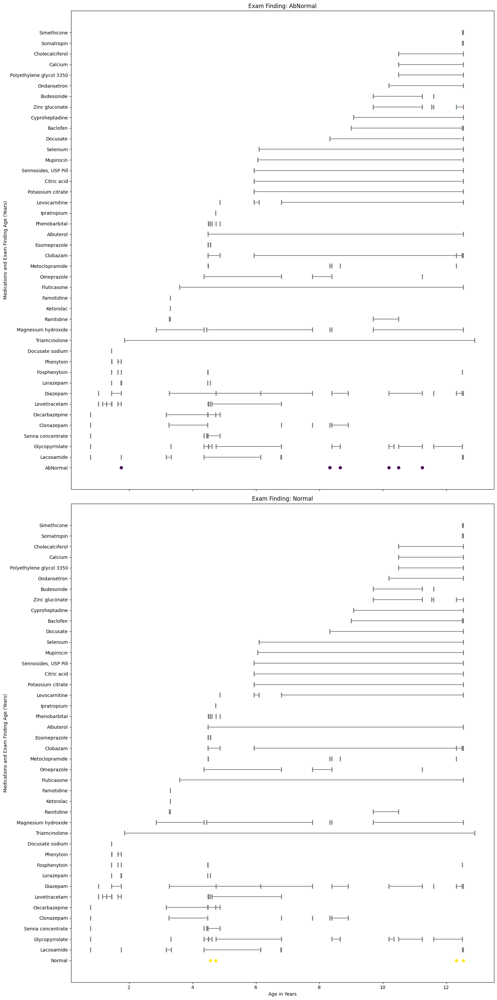

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D

# Assuming your DataFrame loading code is here

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_patients = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications
filtered_medications = medications_df[medications_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]

# Convert age days to years for medications
filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25

# Get the exam_findings for the filtered patients
filtered_exam_findings_df = exam_findings_df[exam_findings_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]
filtered_exam_findings_df['exam_age_year'] = filtered_exam_findings_df['exam_age_days'] / 365.25

## Print all unique medication indication
#print("chorea patients all disease names - medication_indication column medication table")
#print("----------------------------------------------------------------")

#print(filtered_medications['medication_indication'].unique())


# Filter exam_findings by 'exam_section' = 'coordination'
coordination_exam_findings_df = filtered_exam_findings_df[filtered_exam_findings_df['exam_section'] == 'coordination']
coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['patient_uuid'] == '34b93467-94bf-4efa-a5f9-a238ca69c1e1']


print("chorea patients - Unique exam findings in coordination section")
unique_exam_findings = coordination_exam_findings_df['exam_finding'].unique()
print(unique_exam_findings)
print("----------------------------------------------------------------")
print("----------------------------------------------------------------")

## Filter patients who reported both normal and abnormal exam findings

#filtered_exam_findings_df = filtered_exam_findings_df[filtered_exam_findings_df['patient_uuid']
#.isin(['2ae8218c-528b-47e4-a037-9a32bb3c5d1f' , '34b93467-94bf-4efa-a5f9-a238ca69c1e1' '3ea45c51-7672-4658-b8f5-6a06e741b2c1', 
#       '4375594d-d095-4600-abbb-7ab691bf9740' , '6c15327a-2d2b-405f-af5e-6891ecff266f' , '6e5ff106-926c-4c51-a957-6d7f06de421e' , 
#       '6e8a7113-2e40-4704-b82d-5bd35097a29a' , '70310e34-3d1d-4147-b4e9-883e93c6ab26' , '8e2446b4-678c-4599-b2e3-42b21da501a2' , 
#       'aed6f9b4-b9c4-4eca-a566-4c31a16fe109' , 'be7757a3-f074-4e9b-9e11-a8763806d183' , 'd30806e6-d219-4ad4-81c5-1926af98fa14' , 
#       'e35c4641-0e35-43fe-8531-3ff213b583f1' , 'e4f422f0-2847-4c2c-b3c7-fc2d6fd61495'])]



#Filter coordination dataframe more by exam_findings 
#coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding']
#.isin(['Dyskinesia' , 'Stereotypy' 'Dystonia', 'Orofacial dyskinesia' , 'Chorea' , 'Hyperkinesis' , 'Does not perform hand functions' ,
# 'Myoclonus' , 'Abnormal involuntary movement' , 'Uncoordinated movements' , 'Coordination problem' , 'Dysmetria' , 'Choreoathetosis' ,
# 'Decreased coordination' , 'Involuntary movement' , 'Nonpurposeful movements',  'Orofacial chorea' , 'Ataxia' , 'Truncal ataxia' ,
# 'Incoordination' , 'Titubation' ,  'Automatism' , 'Bradykinesia' ,'Orofacial dystonia', 'Athetoid movements', 'Tremulous' ,'Tremor'])]



#coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding'].isin(['No abnormal movement', 'Normal coordination' ])]

#coordination_exam_findings_df['exam_finding'] = 'AbNormal'

# Create normal and abnormal exam findings dataframes

abnormal_coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding']
.isin(['Dyskinesia' , 'Stereotypy' 'Dystonia', 'Orofacial dyskinesia' , 'Chorea' , 'Hyperkinesis' , 'Does not perform hand functions' ,
 'Myoclonus' , 'Abnormal involuntary movement' , 'Uncoordinated movements' , 'Coordination problem' , 'Dysmetria' , 'Choreoathetosis' ,
 'Decreased coordination' , 'Involuntary movement' , 'Nonpurposeful movements',  'Orofacial chorea' , 'Ataxia' , 'Truncal ataxia' ,
 'Incoordination' , 'Titubation' ,  'Automatism' , 'Bradykinesia' ,'Orofacial dystonia', 'Athetoid movements', 'Tremulous' ,'Tremor'])]

abnormal_coordination_exam_findings_df['exam_finding'] = 'AbNormal'

normal_coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding'].isin(['No abnormal movement', 'Normal coordination' ])]

normal_coordination_exam_findings_df['exam_finding'] = 'Normal'

coordination_exam_findings_df = pd.concat([abnormal_coordination_exam_findings_df, normal_coordination_exam_findings_df], ignore_index=True)


# Filter medications that were only take for Chorea related medication_indication
#filtered_medications = filtered_medications[filtered_medications['medication_indication'].isin(["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"])]
# since all these conditions mean same thing, lets put same column name, to show consolidated graph
#filtered_medications['medication_indication'] = "Chorea"

# Get unique exam findings
unique_exam_findings = coordination_exam_findings_df['exam_finding'].unique()
print(unique_exam_findings)
print("----- Showing combined graph for AbNormal finding --- ")


#with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
#    print(coordination_exam_findings_df['patient_uuid'])


# Get unique colors for each exam finding
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_exam_findings)))
color_dict = {finding: color for finding, color in zip(unique_exam_findings, colors)}

# Set up the matplotlib figure and axes
fig, axes = plt.subplots(len(unique_exam_findings), figsize=(15, 15 * len(unique_exam_findings)), sharex=True)

# Ensure axes is an array even if there's only one plot
if len(unique_exam_findings) == 1:
    axes = np.array([axes])

# Plotting
for finding, ax in zip(unique_exam_findings, axes.flatten()):
    # Filter exam findings for the current finding
    current_finding_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding'] == finding]

    # Plot exam findings
    ax.scatter(current_finding_df['exam_age_year'], [finding] * len(current_finding_df), color=color_dict[finding], label=finding)

    # Plot medications for patients with the current exam finding
    for _, row in filtered_medications.iterrows():
        if row['patient_uuid'] in current_finding_df['patient_uuid'].unique():
            ax.plot([row['medication_start_year'], row['medication_end_year']], 
                    [row['medication'], row['medication']],
                    color='grey', linestyle='-', marker='|', markersize=10, markeredgewidth=2)
            ax.scatter([row['medication_start_year']], [row['medication']], color='green', marker='|', s=100)
            ax.scatter([row['medication_end_year']], [row['medication']], color='red', marker='|', s=100)

    # Formatting the subplot
    ax.set_title(f'Exam Finding: {finding}')
    ax.set_ylabel('Medications and Exam Finding Age (Years)')

# Set common X label and adjust layout
plt.xlabel('Age in Years')
plt.tight_layout()
plt.show()


/tmp/ipykernel_121/3230725368.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
/tmp/ipykernel_121/3230725368.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25
/tmp/ipykernel_121/3230725368.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

chorea patients - Unique exam findings in coordination section
['Tremulous' 'No abnormal movement' 'Choreoathetosis' 'Dysmetria'
 'Stereotypy' 'Normal coordination' 'Tremor']
----------------------------------------------------------------
----------------------------------------------------------------
['AbNormal' 'Normal']
----- Showing combined graph for AbNormal finding --- 


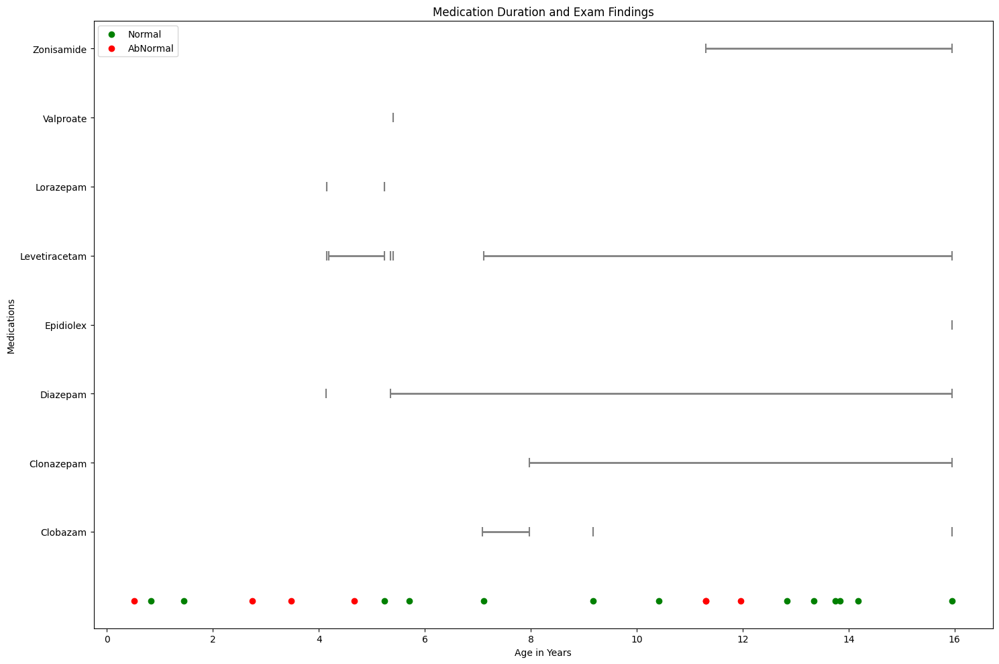

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D

# Assuming your DataFrame loading code is here

# Filter clinical diagnosis for patients with specified conditions
conditions = ["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"]
mask = clinical_diagnosis_df['clinical_diagnosis'].str.contains('|'.join(conditions), case=False, na=False)
filtered_patients = clinical_diagnosis_df[mask]

# Use the filtered patient_uuids to get their medications
filtered_medications = medications_df[medications_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]

# Convert age days to years for medications
filtered_medications['medication_start_year'] = filtered_medications['medication_age_days_firstDate'] / 365.25
filtered_medications['medication_end_year'] = filtered_medications['medication_age_days_lastDate'] / 365.25

# Get the exam_findings for the filtered patients
filtered_exam_findings_df = exam_findings_df[exam_findings_df['patient_uuid'].isin(filtered_patients['patient_uuid'])]
filtered_exam_findings_df['exam_age_year'] = filtered_exam_findings_df['exam_age_days'] / 365.25

## Print all unique medication indication
#print("chorea patients all disease names - medication_indication column medication table")
#print("----------------------------------------------------------------")

#print(filtered_medications['medication_indication'].unique())


# Filter exam_findings by 'exam_section' = 'coordination'
coordination_exam_findings_df = filtered_exam_findings_df[filtered_exam_findings_df['exam_section'] == 'coordination']
coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df
['patient_uuid'] == 'e4f422f0-2847-4c2c-b3c7-fc2d6fd61495']
filtered_medications = filtered_medications[filtered_medications
['patient_uuid'] == 'e4f422f0-2847-4c2c-b3c7-fc2d6fd61495']

print("chorea patients - Unique exam findings in coordination section")
unique_exam_findings = coordination_exam_findings_df['exam_finding'].unique()
print(unique_exam_findings)
print("----------------------------------------------------------------")
print("----------------------------------------------------------------")

## Filter patients who reported both normal and abnormal exam findings

#filtered_exam_findings_df = filtered_exam_findings_df[filtered_exam_findings_df['patient_uuid']
#.isin(['2ae8218c-528b-47e4-a037-9a32bb3c5d1f' , '34b93467-94bf-4efa-a5f9-a238ca69c1e1' '3ea45c51-7672-4658-b8f5-6a06e741b2c1', 
#       '4375594d-d095-4600-abbb-7ab691bf9740' , '6c15327a-2d2b-405f-af5e-6891ecff266f' , '6e5ff106-926c-4c51-a957-6d7f06de421e' , 
#       '6e8a7113-2e40-4704-b82d-5bd35097a29a' , '70310e34-3d1d-4147-b4e9-883e93c6ab26' , '8e2446b4-678c-4599-b2e3-42b21da501a2' , 
#       'aed6f9b4-b9c4-4eca-a566-4c31a16fe109' , 'be7757a3-f074-4e9b-9e11-a8763806d183' , 'd30806e6-d219-4ad4-81c5-1926af98fa14' , 
#       'e35c4641-0e35-43fe-8531-3ff213b583f1' , 'e4f422f0-2847-4c2c-b3c7-fc2d6fd61495'])]



#Filter coordination dataframe more by exam_findings 
#coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding']
#.isin(['Dyskinesia' , 'Stereotypy' 'Dystonia', 'Orofacial dyskinesia' , 'Chorea' , 'Hyperkinesis' , 'Does not perform hand functions' ,
# 'Myoclonus' , 'Abnormal involuntary movement' , 'Uncoordinated movements' , 'Coordination problem' , 'Dysmetria' , 'Choreoathetosis' ,
# 'Decreased coordination' , 'Involuntary movement' , 'Nonpurposeful movements',  'Orofacial chorea' , 'Ataxia' , 'Truncal ataxia' ,
# 'Incoordination' , 'Titubation' ,  'Automatism' , 'Bradykinesia' ,'Orofacial dystonia', 'Athetoid movements', 'Tremulous' ,'Tremor'])]



#coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding'].isin(['No abnormal movement', 'Normal coordination' ])]

#coordination_exam_findings_df['exam_finding'] = 'AbNormal'

# Create normal and abnormal exam findings dataframes

abnormal_coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding']
.isin(['Dyskinesia' , 'Stereotypy' 'Dystonia', 'Orofacial dyskinesia' , 'Chorea' , 'Hyperkinesis' , 'Does not perform hand functions' ,
 'Myoclonus' , 'Abnormal involuntary movement' , 'Uncoordinated movements' , 'Coordination problem' , 'Dysmetria' , 'Choreoathetosis' ,
 'Decreased coordination' , 'Involuntary movement' , 'Nonpurposeful movements',  'Orofacial chorea' , 'Ataxia' , 'Truncal ataxia' ,
 'Incoordination' , 'Titubation' ,  'Automatism' , 'Bradykinesia' ,'Orofacial dystonia', 'Athetoid movements', 'Tremulous' ,'Tremor'])]

abnormal_coordination_exam_findings_df['exam_finding'] = 'AbNormal'

normal_coordination_exam_findings_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding'].isin(['No abnormal movement', 'Normal coordination' ])]

normal_coordination_exam_findings_df['exam_finding'] = 'Normal'

coordination_exam_findings_df = pd.concat([abnormal_coordination_exam_findings_df, normal_coordination_exam_findings_df], ignore_index=True)


# Filter medications that were only take for Chorea related medication_indication
#filtered_medications = filtered_medications[filtered_medications['medication_indication'].isin(["Chorea", "Choreoathetosis", "Chorea-athetoid cerebral palsy"])]
# since all these conditions mean same thing, lets put same column name, to show consolidated graph
#filtered_medications['medication_indication'] = "Chorea"

# Get unique exam findings
unique_exam_findings = coordination_exam_findings_df['exam_finding'].unique()
print(unique_exam_findings)
print("----- Showing combined graph for AbNormal finding --- ")


#with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
#    print(coordination_exam_findings_df['patient_uuid'])

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.lines import Line2D

# Assuming the dataframes 'coordination_exam_findings_df' and 'filtered_medications' are already defined
# and contain the necessary data.

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'coordination_exam_findings_df' and 'filtered_medications' are already defined

# Create color mapping for exam findings
exam_finding_colors = {'Normal': 'green', 'AbNormal': 'red'}

# Initialize the plot
fig, ax = plt.subplots(figsize=(15, 10))

# Get unique medications and sort them
unique_medications = filtered_medications['medication'].unique()
unique_medications.sort()

# Create a dictionary to map medication to y-axis
medication_to_y = {med: i for i, med in enumerate(unique_medications, start=1)}

# Plot each medication as a horizontal line
for _, row in filtered_medications.iterrows():
    y_value = medication_to_y[row['medication']]
    ax.hlines(y=y_value, xmin=row['medication_start_year'], xmax=row['medication_end_year'], color='grey', lw=2)
    ax.scatter(row['medication_start_year'], y_value, color='grey', marker='|', s=100)  # Start of medication
    ax.scatter(row['medication_end_year'], y_value, color='grey', marker='|', s=100)  # End of medication

# Plot exam findings
for finding, color in exam_finding_colors.items():
    current_finding_df = coordination_exam_findings_df[coordination_exam_findings_df['exam_finding'] == finding]
    ax.scatter(current_finding_df['exam_age_year'], np.zeros(len(current_finding_df)), color=color, label=finding, zorder=5)

# Customize the y-axis
ax.set_yticks(list(medication_to_y.values()))
ax.set_yticklabels(unique_medications)

# Set the legend for the plot
ax.legend()

# Set labels and title
ax.set_xlabel('Age in Years')
ax.set_ylabel('Medications')
ax.set_title('Medication Duration and Exam Findings')

plt.tight_layout()
plt.show()
